In [237]:
import cv2
import numpy as np
from matplotlib import pyplot as plt

In [238]:
def draw_prediction(img, class_id, confidence, x, y, x_plus_w, y_plus_h):

    label = str(classes[class_id])

    color = COLORS[class_id]

    cv2.rectangle(img, (x,y), (x_plus_w,y_plus_h), color, 2)

    cv2.putText(img, label, (x-10,y-10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)

In [239]:
image = cv2.imread('PartiallyEncryptedImg.jpg')

print(image.shape)

Width = image.shape[1]
Height = image.shape[0]
scale = 0.00392

type(image)

(576, 768, 3)


numpy.ndarray

In [240]:
classes = None

with open('yolov3.txt', 'r') as f:
    classes = [line.strip() for line in f.readlines()]

print(np.shape(classes))

(80,)


In [241]:
COLORS = np.random.uniform(0, 255, size=(len(classes), 3))

net = cv2.dnn.readNet('yolov3-spp.weights','yolov3-spp.cfg.txt')

blob = cv2.dnn.blobFromImage(image, scale, (416,416), (0,0,0), True, crop=False)

net.setInput(blob)


print(np.shape(COLORS))

(80, 3)


In [242]:
def get_output_layers(net):
    
    layer_names = net.getLayerNames()
    
    output_layers = [layer_names[i - 1] for i in net.getUnconnectedOutLayers()]

    return output_layers

In [243]:
outs = net.forward(get_output_layers(net))
for out in outs:
 print(np.shape(out))

(507, 85)
(2028, 85)
(8112, 85)


In [244]:
class_ids = []
confidences = []
boxes = []
conf_threshold = 0.5
nms_threshold = 0.4

In [245]:
for out in outs:
    for detection in out:
        scores = detection[5:]              #out of 85; from index 5 to last, for each outs row stored in scores, the first 5 for something else, rest 80 for each class possibiltiy value of each class
        class_id = np.argmax(scores)        #seeing which class score max, putting that in class id
        confidence = scores[class_id]       #score of that class
       # print(confidence)
        if confidence > 0.5:
            center_x = int(detection[0] * Width)
            center_y = int(detection[1] * Height)
            w = int(detection[2] * Width)
            h = int(detection[3] * Height)
            x = center_x - w / 2
            y = center_y - h / 2
            class_ids.append(class_id)
            confidences.append(float(confidence))
            boxes.append([x, y, w, h])

print(boxes)

[[469.0, 71.5, 220, 103], [108.0, 127.5, 464, 299], [171.0, 131.0, 420, 290]]


In [246]:
#https://stackoverflow.com/a/66717845  just filtering the bounding box array boxes to find apt index of boxes

indices = cv2.dnn.NMSBoxes(boxes, confidences, conf_threshold, nms_threshold)
print(indices)

[0 1]


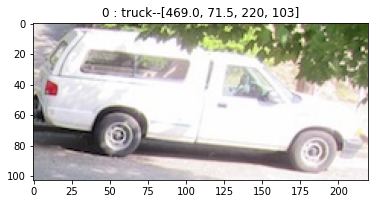

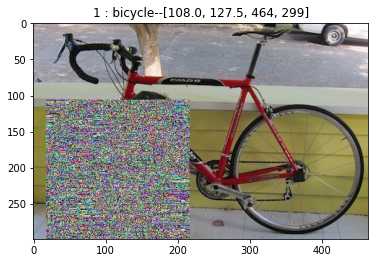

In [247]:
for i in indices:
 # i = i[0]
  box = boxes[i]
  x = round(box[0])
  y = round(box[1])
  w = round(box[2])
  h = round(box[3])
  box_img = image[y:y+h, x:x+w]                         #to see each object box separately, making new image in each obj iteration
  objects = cv2.cvtColor(box_img, cv2.COLOR_BGR2RGB)    #as plt.functins dosnt work on bgr images so conversion, not working for Jen.jpg
  class_id = class_ids[i]
  plt.imshow(objects)                                  #The plt.imShow () function is responsible for processing the image and displaying its format, while plt.show() displays the function processed by plt.imShow ().
  plt.title(str(i) + ' : ' + classes[class_id]+ "--"+ str(box))
  plt.show()
  #bottom left corner; minus first two values

In [248]:
#to draw the box in the final output image
"""""
for i in indices:
   # i = i[0]
    box = boxes[i]
    x = box[0]
    y = box[1]
    w = box[2]
    h = box[3]
    draw_prediction(image, class_ids[i], confidences[i], round(x), round(y), round(x+w), round(y+h))"""


'""\nfor i in indices:\n   # i = i[0]\n    box = boxes[i]\n    x = box[0]\n    y = box[1]\n    w = box[2]\n    h = box[3]\n    draw_prediction(image, class_ids[i], confidences[i], round(x), round(y), round(x+w), round(y+h))'

In [249]:
"""RGB_im = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
plt.imshow(RGB_im)
plt.title('Object detected image')
plt.show()
    
cv2.imwrite("object-detection.jpg", image)"""

'RGB_im = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)\nplt.imshow(RGB_im)\nplt.title(\'Object detected image\')\nplt.show()\n    \ncv2.imwrite("object-detection.jpg", image)'

In [250]:
"""cv2.imshow("object detecion", image)
cv2.waitKey()
    
cv2.imwrite("object-detection.jpg", image)
cv2.destroyAllWindows()"""

'cv2.imshow("object detecion", image)\ncv2.waitKey()\n    \ncv2.imwrite("object-detection.jpg", image)\ncv2.destroyAllWindows()'

In [251]:
print("Please enter the index number for your object of interest")
a=int(input("Give"))
print("Object of interest index number is : " +str(a) )

Please enter the index number for your object of interest
Object of interest index number is : 1


In [252]:
box_of_interest=boxes[a]
print(str(box_of_interest))

[108.0, 127.5, 464, 299]


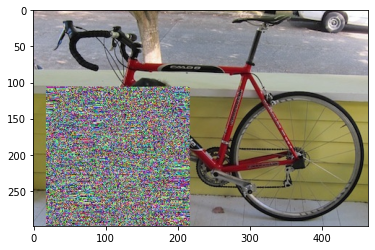

In [253]:
  x = round(box_of_interest[0])
  y = round(box_of_interest[1])
  w = round(box_of_interest[2])
  h = round(box_of_interest[3])
  interest_img = image[y:y+h, x:x+w]                         #to see each object box separately, making new image in each obj iteration
  rbg_obj = cv2.cvtColor(interest_img, cv2.COLOR_BGR2RGB) 
  plt.imshow(rbg_obj)  
  plt.show()

Encrypting the object

In [254]:
#cv2.imshow(rbg_obj)
type(rbg_obj)
row,col,c=rbg_obj.shape
print(row)

299


In [255]:
#accessing each r,g,b component of each pixel
for i in range(0,row):
  for j in range(0,col):
    print(rbg_obj[i,j])
    r,g,b=rbg_obj[i,j]
    print(r)
    print(g)
    print(b)
    print("=====")

[180 168 170]
180
168
170
=====
[171 159 161]
171
159
161
=====
[167 152 157]
167
152
157
=====
[174 159 162]
174
159
162
=====
[182 166 166]
182
166
166
=====
[190 174 174]
190
174
174
=====
[198 180 180]
198
180
180
=====
[199 180 182]
199
180
182
=====
[197 179 179]
197
179
179
=====
[193 177 177]
193
177
177
=====
[186 172 172]
186
172
172
=====
[180 166 166]
180
166
166
=====
[182 168 168]
182
168
168
=====
[178 164 164]
178
164
164
=====
[171 157 157]
171
157
157
=====
[168 156 158]
168
156
158
=====
[171 159 161]
171
159
161
=====
[168 156 158]
168
156
158
=====
[166 154 156]
166
154
156
=====
[170 158 158]
170
158
158
=====
[175 161 161]
175
161
161
=====
[175 161 161]
175
161
161
=====
[177 162 165]
177
162
165
=====
[177 165 167]
177
165
167
=====
[172 162 161]
172
162
161
=====
[169 159 158]
169
159
158
=====
[170 160 158]
170
160
158
=====
[173 162 160]
173
162
160
=====
[181 167 167]
181
167
167
=====
[183 167 168]
183
167
168
=====
[181 162 164]
181
162
164
=====
[181 162

In [256]:
#checking if randomm ints or not
def freq(arr):
   elements_count = {}
   # iterating over the elements for frequency
   for element in arr:
   # checking whether it is in the dict or not
      if element in elements_count:
      # incerementing the count by 1
         elements_count[element] += 1
      else:
      # setting the count to 1
         elements_count[element] = 1
# printing the elements frequencies
   for key, value in elements_count.items():
      if(value != 1):
       print(f"{key}: {value}")

In [257]:
from numpy.random import default_rng

rng1 = default_rng()
array_r = rng1.choice(256, size=256, replace=False)
freq(array_r)
rng2 =default_rng()
array_g = rng2.choice(256, size=256, replace=False)
freq(array_g)
array_b = rng2.choice(256, size=256, replace=False)
freq(array_b)

In [258]:
"""#creating random first row of 3 rgb arrays
array_r = np.random.randint(256, size=(256))
array_g = np.random.randint(256, size=(256))
array_b = np.random.randint(256, size=(256))
print(array_r)"""


'#creating random first row of 3 rgb arrays\narray_r = np.random.randint(256, size=(256))\narray_g = np.random.randint(256, size=(256))\narray_b = np.random.randint(256, size=(256))\nprint(array_r)'

In [259]:
print(array_r[150])

238


In [260]:
#make each rgb matrix
matrix_r = np.zeros([row,256],dtype=np.uint8)
matrix_g = np.zeros(shape=(row,256),dtype=np.uint8)
matrix_b = np.zeros(shape=(row,256),dtype=np.uint8)
print(matrix_r)


[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]


In [261]:
#first row random values insertion
matrix_r[0]=array_r
matrix_g[0]=array_g
matrix_b[0]=array_b

print(len(matrix_r))
print(row)
print(len(matrix_r[0]))

299
299
256


In [262]:
#right rotate array elements of 
def rightRotate(lists, num):
    output_list = []
 
    # Will add values from n to the new list
    for item in range(len(lists) - num, len(lists)):
        output_list.append(lists[item])
 
    # Will add the values before
    # n to the end of new list
    for item in range(0, len(lists) - num):
        output_list.append(lists[item])
    
   #print(output_list)

    return output_list

In [263]:
#matrix_r set up
array_shifting = np.random.randint(256, size=(row))
print(np.max(array_shifting))
for i in range(1, row):
  matrix_r[i]=rightRotate(matrix_r[0],array_shifting[i])
  #if(i==150):
    #print(matrix_r[0][i])
  #print("===") 

 

254


In [264]:
#matrix_g set up
#array_shifting = np.random.randint(256, size=(row))
for i in range(1, row):
  #print(rightRotate(matrix_r[0],i))
 # print("===")
  matrix_g[i]=rightRotate(matrix_g[0],array_shifting[i]) 

In [265]:
#matrix_b set up
#array_shifting = np.random.randint(256, size=(row))
for i in range(1, row):
  #print(rightRotate(matrix_r[0],i))
 # print("===")
  matrix_b[i]=rightRotate(matrix_b[0],array_shifting[i]) 

In [266]:
#Step 5: Encryption
for k in range(4):
  for i in range(row):
    for j in range(col):
        rbg_obj[i][j][0]=matrix_r[i][rbg_obj[i][j][0]]
        rbg_obj[i][j][1]=matrix_g[i][rbg_obj[i][j][1]]
        rbg_obj[i][j][2]=matrix_b[i][rbg_obj[i][j][2]]
print(rbg_obj[0][0][0])

224


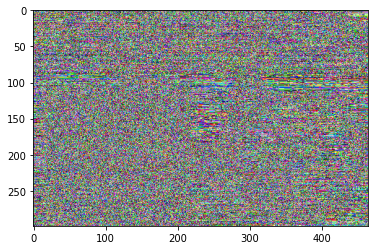

In [267]:
plt.imshow(rbg_obj)
plt.show()

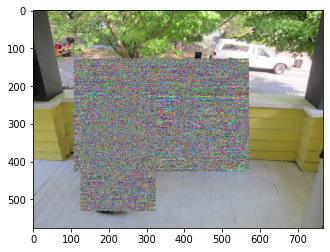

True

In [268]:
#Partially Encrypted img
Encrypted_img=cv2.cvtColor(image, cv2.COLOR_BGR2RGB) 
Encrypted_img[y:y+h, x:x+w]=rbg_obj
plt.imshow(Encrypted_img)
plt.show()

cv2.imwrite("PartiallyEncryptedImg.jpg", cv2.cvtColor(Encrypted_img,cv2.COLOR_RGB2BGR))

In [269]:
print(rbg_obj[0][0][0])

224


In [270]:
""""" error to figure out
#Decryption
for i in range(row):
  for j in range(col):
    for k in range(col):
      if(rbg_obj[i][j][0]==matrix_r[i][k]):
        rbg_obj[i][j][0]=k
      if(rbg_obj[i][j][1]==matrix_g[i][k]):
        rbg_obj[i][j][1]=k
      if(rbg_obj[i][j][2]==matrix_b[i][k]):
        rbg_obj[i][j][2]=k"""

'"" error to figure out\n#Decryption\nfor i in range(row):\n  for j in range(col):\n    for k in range(col):\n      if(rbg_obj[i][j][0]==matrix_r[i][k]):\n        rbg_obj[i][j][0]=k\n      if(rbg_obj[i][j][1]==matrix_g[i][k]):\n        rbg_obj[i][j][1]=k\n      if(rbg_obj[i][j][2]==matrix_b[i][k]):\n        rbg_obj[i][j][2]=k'

In [271]:
#Decryption
for k in range(4):
  for i in range(row):
    for j in range(col):
        rbg_obj[i][j][0]=(np.where(matrix_r[i] == rbg_obj[i][j][0])[0][0])
        rbg_obj[i][j][1]=(np.where(matrix_g[i] == rbg_obj[i][j][1])[0][0])
        rbg_obj[i][j][2]=(np.where(matrix_b[i] == rbg_obj[i][j][2])[0][0])
  print(rbg_obj[0][0])

[235  13 151]
[73 60 11]
[234 223 225]
[180 168 170]


In [272]:
for i in range(0,row):
  for j in range(0,col):
    print(rbg_obj[i,j])
    r,g,b=rbg_obj[i,j]
    print(r)
    print(g)
    print(b)
    print("=====")

[180 168 170]
180
168
170
=====
[171 159 161]
171
159
161
=====
[167 152 157]
167
152
157
=====
[174 159 162]
174
159
162
=====
[182 166 166]
182
166
166
=====
[190 174 174]
190
174
174
=====
[198 180 180]
198
180
180
=====
[199 180 182]
199
180
182
=====
[197 179 179]
197
179
179
=====
[193 177 177]
193
177
177
=====
[186 172 172]
186
172
172
=====
[180 166 166]
180
166
166
=====
[182 168 168]
182
168
168
=====
[178 164 164]
178
164
164
=====
[171 157 157]
171
157
157
=====
[168 156 158]
168
156
158
=====
[171 159 161]
171
159
161
=====
[168 156 158]
168
156
158
=====
[166 154 156]
166
154
156
=====
[170 158 158]
170
158
158
=====
[175 161 161]
175
161
161
=====
[175 161 161]
175
161
161
=====
[177 162 165]
177
162
165
=====
[177 165 167]
177
165
167
=====
[172 162 161]
172
162
161
=====
[169 159 158]
169
159
158
=====
[170 160 158]
170
160
158
=====
[173 162 160]
173
162
160
=====
[181 167 167]
181
167
167
=====
[183 167 168]
183
167
168
=====
[181 162 164]
181
162
164
=====
[181 162

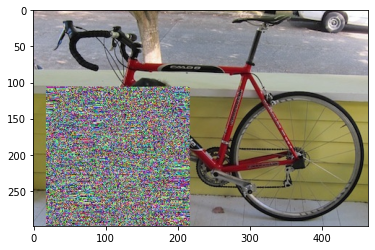

In [273]:
plt.imshow(rbg_obj)
plt.show()

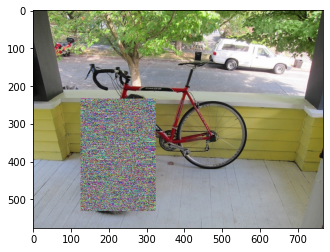

True

In [274]:
#Decrypted img
Decrypted_img=cv2.cvtColor(image, cv2.COLOR_BGR2RGB) 
Decrypted_img[y:y+h, x:x+w]=rbg_obj
plt.imshow(Decrypted_img)
plt.show()
cv2.imwrite("DecryptedImage.jpg", image)

In [275]:
from PIL import Image
import numpy as np

"""
    This method compares two image.If the pixel value is same then 0 is stored in the matrix else one is stored
"""
def rateofchange(height,width,pixel1,pixel2,matrix,i):

    for y in range(0,height):
        for x in range(0,width):
            #print(x,y)
            if pixel1[x,y][i] == pixel2[x,y][i]:
                matrix[x,y]=0
            else:
                matrix[x,y]=1
    return matrix
"""
    sum of the values of 1 stored in matrix is calculated
"""
def sumofpixel(height,width,pixel1,pixel2,ematrix,i):
    matrix=rateofchange(height,width,pixel1,pixel2,ematrix,i)
    psum=0
    for y in range(0,height):
        for x in range(0,width):
            psum=matrix[x,y]+psum
    return psum

"""
Finally the above two module is called to calculate the values
"""
def npcrv(loc1,loc2):
    c1 = Image.open(loc1)
    c2 = Image.open(loc2)
    width, height = c1.size
    pixel1 = c1.load()
    pixel2 = c2.load()
    ematrix = np.empty([width, height])
    per=(((sumofpixel(height,width,pixel1,pixel2,ematrix,0)/(height*width))*100)+((sumofpixel(height,width,pixel1,pixel2,ematrix,1)/(height*width))*100)+((sumofpixel(height,width,pixel1,pixel2,ematrix,2)/(height*width))*100))/3
    return per

print(npcrv("PartiallyEncryptedImg.jpg","dog.jpg"))

74.05455789448303


In [276]:
from PIL import Image
import math
# Sama as NPCR both are used for sensitivity analysis two encrypted image is required

"""
Unified average avereage inensity changed rate
this code calculates average intensity change rate of pixels
"""
def uaci(loc1,loc2):
    image1 = Image.open(loc1)
    image2 = Image.open(loc2)
    pixel1=image1.load()
    pixel2=image2.load()
    width,height=image1.size
    value=0.0
    for y in range(0,height):
        for x in range(0,width):
            value=(abs(pixel1[x,y][0]-pixel2[x,y][0])/255)+value

    value=(value/(width*height))*100
    return value

print(uaci("PartiallyEncryptedImg.jpg","dog.jpg"))

8.632913560386422


In [277]:

from PIL import Image
from pylab import *
import matplotlib.pylab as plt
import matplotlib.pylab as plt2


def rgbhistogram(loc,output):

    im = array(Image.open(loc).convert('RGB'))

    im2 = 255 - im  # invert image green
    im3 = (100.0 / 255) * im + 100  # clamp to interval 100...200 red
    im4 = 255.0 * (im / 255.0) ** 2  # squared blue
    plt2.axis('equal')
    plt2.axis('off')
    plt2.figure()
    plt2.hist(im2.flatten(), 128)
    plt2.hist(im3.flatten(), 128)
    plt2.hist(im4.flatten(), 128)
    plt2.savefig(output+"/rgbhisto.png")


def rgbhistogram2(loc,output):
    im = array(Image.open(loc).convert('RGB'))

    im2 = 255 - im  # invert image green
    im3 = (100.0 / 255) * im + 100  # clamp to interval 100...200 red
    im4 = 255.0 * (im / 255.0) ** 2  # squared blue
    plt2.axis('equal')
    plt2.axis('on')
    plt2.figure()
    plt2.hist(im2.flatten(), 128)
    plt2.hist(im3.flatten(), 128)
    plt2.hist(im4.flatten(), 128)
    plt2.savefig(output+"/rgbhisto2.png")


def redhistogram(loc):
    im = array(Image.open(loc).convert('RGB')) #Opening the image
    im = (100.0 / 255) * im + 100  # clamp to interval 100...200 red
    #Fecthing red pixels
    axis('equal')
    axis('off')
    figure()
    hist(im.flatten(), 128) #Designing the histogram

    show()


def greenhistogram(loc):
    im = array(Image.open(loc).convert('RGB')) #Opening the image
    im = 255 - im  # invert image green #Fecthing green pixels
    axis('equal')
    axis('off')
    figure()
    hist(im.flatten(), 128)#Designing the histogram
    show()


def bluehistogram(loc):
    im = array(Image.open(loc).convert('RGB')) #Opening the image
    im = 255.0 * (im / 255.0) ** 2  # squared blue #Fecthing blue pixels
    axis('equal')
    axis('off')
    figure()
    hist(im.flatten(), 128)#Designing the histogram
    show()


redhistogram("en.png")
redhistogram("in.png")


bluehistogram("en.png")
bluehistogram("in.png")


greenhistogram("en.png")
#rgbhistogram("PartiallyEncryptedImg.jpg")




greenhistogram("in.png")

FileNotFoundError: [Errno 2] No such file or directory: 'en.png'